# Enable Inline Display in Jupyter
For displaying plots inline in the notebook, enable inline plotting

# Preliminary settings
Libraries imported.

TensorFlow and other relevant libraries for building the image captioning model.

In [1]:
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm


def setup_bengali_fonts():
    """Setup Bengali fonts for matplotlib with fallback options"""

    # Preferred Bengali fonts in order
    bengali_fonts = [
        "Kalpurush",  # Very clear, good for rendering
        "SolaimanLipi",  # Widely used in Bangladesh
        "Noto Sans Bengali",  # Modern Google font
        "Noto Sans Bengali UI",  # UI variant of Noto
        "Noto Serif Bengali",  # Serif version of Noto
        "Mukti",  # Lightweight fallback
        "Vrinda",  # Windows Bengali font
        "Lohit Bengali",  # Linux Bengali font
    ]

    # Latin fallback fonts
    latin_fallbacks = [
        "DejaVu Sans",  # strong coverage for Latin
        "FreeSerif",  # wide Unicode support
        "Arial Unicode MS",  # optional if available
        "sans-serif",  # system fallback
    ]

    # Collect installed fonts
    available_fonts = [f.name for f in fm.fontManager.ttflist]

    # Pick the first available Bengali font
    working_font = None
    for font in bengali_fonts:
        if font in available_fonts:
            working_font = font
            print(f"✅ Using Bengali font: {font}")
            break

    if not working_font:
        print("⚠️ No Bengali font found, falling back to Latin only")
        working_font = latin_fallbacks[0]

    # Keep only installed fallbacks + always include generic "sans-serif"
    valid_fallbacks = [
        f for f in latin_fallbacks if f in available_fonts or f == "sans-serif"
    ]

    # Final font chain
    plt.rcParams["font.family"] = [working_font] + valid_fallbacks

    # Set consistent rendering defaults
    plt.rcParams["font.size"] = 12
    plt.rcParams["axes.unicode_minus"] = False  # fix minus sign rendering

    print("🎨 Current matplotlib font family:", plt.rcParams["font.family"])
    return working_font

In [2]:
def test_bengali_rendering():
    """Test Bengali text rendering using mplcairo (for plots) and Pillow (for shaped text)"""
    fig, ax = plt.subplots(figsize=(8, 4))

    bengali_text = "বাংলা ভাষা সুন্দর"  # "Bengali language is beautiful"
    english_text = "Bengali Language"
    working_font = plt.rcParams["font.family"][0]

    # --- Matplotlib text (uses mplcairo shaping) ---
    ax.text(0.5, 0.7, bengali_text, fontsize=16, ha="center", transform=ax.transAxes)
    ax.text(0.5, 0.5, english_text, fontsize=14, ha="center", transform=ax.transAxes)
    ax.text(
        0.5,
        0.3,
        f"Font: {working_font}",
        fontsize=12,
        ha="center",
        transform=ax.transAxes,
    )

    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    ax.set_title("Bengali Font Rendering Test")
    ax.axis("off")

    plt.tight_layout()
    plt.show()

    # --- Pillow rendering (direct FreeType shaping) ---
    try:
        img = Image.new("RGB", (600, 200), "white")
        draw = ImageDraw.Draw(img)

        # Find a Bengali font path
        font_path = None
        for f in fm.findSystemFonts(fontpaths=None, fontext="ttf"):
            if "Kalpurush" in f or "SolaimanLipi" in f or "NotoSansBengali" in f:
                font_path = f
                break

        if font_path:
            font = ImageFont.truetype(font_path, 40)
            draw.text((50, 80), bengali_text, font=font, fill="black")
            img.show()
            print(f"✅ Pillow text rendered using {font_path}")
        else:
            print("⚠️ No Bengali font found for Pillow rendering")

    except Exception as e:
        print("⚠️ Pillow Bengali rendering failed:", e)

    return fig

In [3]:
# --- GPU Configuration ---
# Set ENABLE_GPU_LIMITS to False when training on a capable machine
ENABLE_GPU_LIMITS = True  # True = limit VRAM, False = allow full VRAM but enable growth
GPU_MEMORY_LIMIT_MB = (
    2000  # Set an int (MB) to fix the limit, or None for auto 80% capacity
)
MIN_SAFE_VRAM_MB = 1024  # Warn if limit is set below this (1GB default)

In [4]:
# --- Configuration ---
import os
from pathlib import Path

# Repository root (one directory up from current working directory)
ROOT = str(Path.cwd().parent.resolve())

# /data/test
BASE_DATASET_DIR = os.path.abspath(os.path.join(ROOT, "data", "test"))  # <<-- Dataset directory

print(f"Using BASE_DATASET_DIR = {BASE_DATASET_DIR}")

# Can be int, None, -1, or "inf"
TEST_LIMIT = "inf"  # Number of images to use in testing
VALIDATE_IMAGES = True  # Ensure image files exist before using

# Toggle training vs inference only mode.
# Set DO_TRAIN = False to ensure this notebook performs ONLY inference and never runs training.
DO_TRAIN = False  # <<-- Inference-only mode (no training will be executed)

Using BASE_DATASET_DIR = /data/test


In [5]:
from typing import Dict, List
from caption_parsers import collect_all_caption_data

# --- Load all caption data from supported formats ---
caption_mapping: Dict[str, List[str]] = collect_all_caption_data(
    base_dir=BASE_DATASET_DIR, validate_images=VALIDATE_IMAGES
)

🔍 Scanning directories in /data/test...
✅ Added 1000 captions from test.txt
✅ Added 500 captions from Test-Annotation-Bangla Natural Language Image to Text (BNLIT).txt

📦 Total consolidated caption mappings: 1500


In [6]:
# --- Shuffle and Prepare Dataset ---
import random


image_paths = list(caption_mapping.keys())
random.shuffle(image_paths)

# Handle different TRAIN_LIMIT formats
if isinstance(TEST_LIMIT, str) and TEST_LIMIT.strip().lower() == "inf":
    test_image_paths = image_paths
elif TEST_LIMIT is None or TEST_LIMIT == -1:
    test_image_paths = image_paths
elif isinstance(TEST_LIMIT, (int, float)) and TEST_LIMIT > 0:
    test_image_paths = image_paths[: int(TEST_LIMIT)]
else:
    raise ValueError(f"Invalid TRAIN_LIMIT value: {TEST_LIMIT}")

print(f"✅ Using {len(test_image_paths)} image paths for testing")

✅ Using 1500 image paths for testing


In [7]:
# Build flat caption list and matching image list
from typing import List

test_captions: List[str] = []
img_name_vector: List[str] = []

for image_path in test_image_paths:
    captions = caption_mapping.get(image_path, [])
    if not captions:
        continue
    test_captions.extend([f"<start> {cap} <end>" for cap in captions])
    img_name_vector.extend([image_path] * len(captions))

Preprocess the images using InceptionV3
Next, you will use InceptionV3 (which is pretrained on Imagenet) to classify each image. You will extract features from the last convolutional layer.

First, you will convert the images into InceptionV3's expected format by:

Resizing the image to 299px by 299px
Preprocess the images using the preprocess_input method to normalize the image so that it contains pixels in the range of -1 to 1, which matches the format of the images used to train InceptionV3.

In [8]:
import tensorflow as tf
import numpy as np
import cv2

IMG_SIZE = (299, 299)


def load_image_cv(path):
    path = path.numpy().decode() if isinstance(path, tf.Tensor) else path
    img = cv2.imread(path)
    if img is None:
        raise ValueError(f"Failed to load image: {path}")
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, IMG_SIZE)
    img = tf.keras.applications.inception_v3.preprocess_input(img.astype(np.float32))
    return img, path


def safe_load_image(path):
    try:
        return load_image_cv(path)
    except Exception as e:
        msg = f"⚠️ Skipping unreadable image: {path.numpy().decode()}"
        print(msg)
        with open("/results/skipped_images.log", "a", encoding="utf-8") as log_file:
            log_file.write(msg + "\n")
        return np.zeros((*IMG_SIZE, 3), dtype=np.float32), path.numpy().decode()


def tf_safe_load_image(path):
    image, path_str = tf.py_function(safe_load_image, [path], [tf.float32, tf.string])
    image.set_shape([*IMG_SIZE, 3])
    path_str.set_shape([])
    return image, path_str

Initialize InceptionV3 and load the pretrained Imagenet weights
Now you'll create a tf.keras model where the output layer is the last convolutional layer in the InceptionV3 architecture. The shape of the output of this layer is 8x8x2048. You use the last convolutional layer because you are using attention in this example. You don't perform this initialization during training because it could become a bottleneck.

You forward each image through the network and store the resulting vector in a dictionary (image_name --> feature_vector).
After all the images are passed through the network, you pickle the dictionary and save it to disk.

In [9]:
image_model = tf.keras.applications.InceptionV3(include_top=False, weights="imagenet")
new_input = image_model.input
hidden_layer = image_model.layers[-1].output

image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

2025-12-31 15:56:01.732452: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:922] could not open file to read NUMA node: /sys/bus/pci/devices/0000:02:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-12-31 15:56:01.806064: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:922] could not open file to read NUMA node: /sys/bus/pci/devices/0000:02:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-12-31 15:56:01.806753: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:922] could not open file to read NUMA node: /sys/bus/pci/devices/0000:02:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-12-31 15:56:01.809322: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the app

Preprocess and tokenize the captions
First, you'll tokenize the captions (for example, by splitting on spaces). This gives us a vocabulary of all of the unique words in the data (for example, "surfing", "football", and so on).
Next, you'll limit the vocabulary size to the top 5,000 words (to save memory). You'll replace all other words with the token "UNK" (unknown).
You then create word-to-index and index-to-word mappings.
Finally, you pad all sequences to be the same length as the longest one.

In [10]:
# Find the maximum length of any caption in our dataset
def calc_max_length(tensor):
    return max(len(t) for t in tensor)

In [11]:
import tensorflow as tf

# Choose the top 5000 words from the vocabulary
top_k = 10000  # can adjust to 5000 if needed
tokenizer = tf.keras.preprocessing.text.Tokenizer(
    num_words=top_k,
    oov_token="<unk>",  # will replace unknown words
    filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ',  # removes unwanted characters
)
tokenizer.fit_on_texts(test_captions)
train_seqs = tokenizer.texts_to_sequences(test_captions)

In [12]:
# Vocabulary and caption length statistics
from collections import Counter
import numpy as np

# test_captions should already be defined earlier in the notebook
caps = [c.replace("<start>", "").replace("<end>", "").strip() for c in test_captions]
tokens = [tok for c in caps for tok in c.split()]
vocab = set(tokens)
print(f"📚 Distinct tokens (vocab size): {len(vocab)}")
# caption lengths in tokens (excluding <start>/<end>)
lengths = [len(c.split()) for c in caps]
print(
    f"🔢 Captions: count={len(lengths)}; min={np.min(lengths)}; max={np.max(lengths)}; mean={np.mean(lengths):.2f}; median={np.median(lengths)}; std={np.std(lengths):.2f}"
)
# show top-20 most common tokens
counter = Counter(tokens)
print("Top 20 most frequent tokens:")
for t, n in counter.most_common(20):
    print(f"{t}: {n}")

📚 Distinct tokens (vocab size): 2805
🔢 Captions: count=5500; min=2; max=22; mean=6.37; median=6.0; std=2.90
Top 20 most frequent tokens:
আছে: 2472
একজন: 2302
একটি: 1858
মানুষ: 1071
দাড়িয়ে: 822
বসে: 795
আছে।: 752
ছেলে: 732
পুরুষ: 597
কিছু: 539
দিয়ে: 492
ও: 434
নিয়ে: 426
লোক: 371
জন: 348
মেয়ে: 347
শিশু: 333
যাচ্ছে: 296
নৌকা: 278
করছে: 273


In [13]:
tokenizer.word_index["<pad>"] = 0
tokenizer.index_word[0] = "<pad>"

In [14]:
# Pad each vector to the max_length of the captions
# If you do not provide a max_length value, pad_sequences calculates it automatically
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding="post")

In [15]:
# Calculates the max_length, which is used to store the attention weights
max_length = calc_max_length(train_seqs)

In [16]:
import collections
import random


img_to_cap_vector = collections.defaultdict(list)
for img, cap in zip(img_name_vector, cap_vector):
    img_to_cap_vector[img].append(cap)

# Create training and validation sets using an 80-20 split randomly.
img_keys = list(img_to_cap_vector.keys())
random.shuffle(img_keys)

slice_index = int(len(img_keys) * 0.8)
img_name_train_keys, img_name_val_keys = img_keys[:slice_index], img_keys[slice_index:]

img_name_train = []
cap_train = []
for imgt in img_name_train_keys:
    capt_len = len(img_to_cap_vector[imgt])
    img_name_train.extend([imgt] * capt_len)
    cap_train.extend(img_to_cap_vector[imgt])

img_name_val = []
cap_val = []
for imgv in img_name_val_keys:
    capv_len = len(img_to_cap_vector[imgv])
    img_name_val.extend([imgv] * capv_len)
    cap_val.extend(img_to_cap_vector[imgv])

In [17]:
len(img_name_train), len(cap_train), len(img_name_val), len(cap_val)

(4420, 4420, 1080, 1080)

Create a tf.data dataset for training
Our images and captions are ready! Next, let's create a tf.data dataset to use for training our model.

In [18]:
import tensorflow as tf
import numpy as np
import os

# Configuration
BATCH_SIZE = 64
BUFFER_SIZE = 1000
embedding_dim = 256
units = 512
vocab_size = top_k + 1
num_steps = len(img_name_train) // BATCH_SIZE
# Shape of the vector extracted from InceptionV3 is (64, 2048)
# These two variables represent that vector shape
features_shape = 2048
attention_features_shape = 64

In [19]:
# -------- SAFE LOADING FUNC -------- #
# Safe loader
def safe_map_func(img_name, cap):
    try:
        img_path = img_name.decode("utf-8") + ".npy"
        if not os.path.exists(img_path):
            raise FileNotFoundError(f"❌ File not found: {img_path}")
        img_tensor = np.load(img_path).astype(np.float32)
        return img_tensor, cap
    except Exception as e:
        print(f"⚠️ Skipping sample due to error: {e}")
        dummy_tensor = np.zeros(
            (attention_features_shape, features_shape), dtype=np.float32
        )
        # Return dummy caption of same shape as real ones but filled with -1
        return dummy_tensor, np.full_like(cap, fill_value=-1)

In [20]:
def tf_safe_map_func(img_name, cap):
    img_tensor, cap = tf.numpy_function(
        safe_map_func, [img_name, cap], [tf.float32, tf.int32]
    )
    img_tensor.set_shape([attention_features_shape, features_shape])
    cap.set_shape([max_length])
    return img_tensor, cap

In [21]:
# -------- DATASET PIPELINE -------- #
# Dataset pipeline

# Create dataset from filenames and caption indices
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Apply mapping safely
dataset = dataset.map(tf_safe_map_func, num_parallel_calls=tf.data.AUTOTUNE)

# Filter out samples where all caption tokens are -1
dataset = dataset.filter(lambda img, cap: tf.reduce_any(tf.not_equal(cap, -1)))

# Shuffle, batch and prefetch
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(tf.data.AUTOTUNE)

In [22]:
# -------- VALIDATION DATASET PIPELINE -------- #
val_dataset = tf.data.Dataset.from_tensor_slices((img_name_val, cap_val))

# Apply safe map
val_dataset = val_dataset.map(tf_safe_map_func, num_parallel_calls=tf.data.AUTOTUNE)

# Filter out samples where all caption tokens are -1
val_dataset = val_dataset.filter(lambda img, cap: tf.reduce_any(tf.not_equal(cap, -1)))

# Batch and prefetch (no shuffle for validation)
val_dataset = val_dataset.batch(BATCH_SIZE)
val_dataset = val_dataset.prefetch(tf.data.AUTOTUNE)

val_steps = len(img_name_val) // BATCH_SIZE

Model:

Fun fact: the decoder below is identical to the one in the example for Neural Machine Translation with Attention.

The model architecture is inspired by the Show, Attend and Tell paper.

In this example, you extract the features from the lower convolutional layer of InceptionV3 giving us a vector of shape (8, 8, 2048).
You squash that to a shape of (64, 2048).
This vector is then passed through the CNN Encoder (which consists of a single Fully connected layer).
The RNN (here GRU) attends over the image to predict the next word.

In [23]:
class BahdanauAttention(tf.keras.Model):
    def __init__(self, units):
        super(BahdanauAttention, self).__init__()
        self.W1 = tf.keras.layers.Dense(units)
        self.W2 = tf.keras.layers.Dense(units)
        self.V = tf.keras.layers.Dense(1)

    def call(self, features, hidden):
        # features(CNN_encoder output) shape == (batch_size, 64, embedding_dim)

        # hidden shape == (batch_size, hidden_size)
        # hidden_with_time_axis shape == (batch_size, 1, hidden_size)
        hidden_with_time_axis = tf.expand_dims(hidden, 1)

        # attention_hidden_layer shape == (batch_size, 64, units)
        attention_hidden_layer = tf.nn.tanh(
            self.W1(features) + self.W2(hidden_with_time_axis)
        )

        # score shape == (batch_size, 64, 1)
        # This gives you an unnormalized score for each image feature.
        score = self.V(attention_hidden_layer)

        # attention_weights shape == (batch_size, 64, 1)
        attention_weights = tf.nn.softmax(score, axis=1)

        # context_vector shape after sum == (batch_size, hidden_size)
        context_vector = attention_weights * features
        context_vector = tf.reduce_sum(context_vector, axis=1)

        return context_vector, attention_weights

In [24]:
class CNN_Encoder(tf.keras.Model):
    # Since you have already extracted the features and dumped it using pickle
    # This encoder passes those features through a Fully connected layer
    def __init__(self, embedding_dim):
        super(CNN_Encoder, self).__init__()
        # shape after fc == (batch_size, 64, embedding_dim)
        self.fc = tf.keras.layers.Dense(embedding_dim)

    def call(self, x):
        x = self.fc(x)
        x = tf.nn.relu(x)
        return x

In [25]:
class RNN_Decoder(tf.keras.Model):
    def __init__(self, embedding_dim, units, vocab_size):
        super(RNN_Decoder, self).__init__()
        self.units = units

        self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
        self.gru = tf.keras.layers.GRU(
            self.units,
            return_sequences=True,
            return_state=True,
            recurrent_initializer="glorot_uniform",
        )
        self.fc1 = tf.keras.layers.Dense(self.units)
        self.fc2 = tf.keras.layers.Dense(vocab_size)

        self.attention = BahdanauAttention(self.units)

    def call(self, x, features, hidden):
        # defining attention as a separate model
        context_vector, attention_weights = self.attention(features, hidden)

        # x shape after passing through embedding == (batch_size, 1, embedding_dim)
        x = self.embedding(x)

        # x shape after concatenation == (batch_size, 1, embedding_dim + hidden_size)
        x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)

        # passing the concatenated vector to the GRU
        output, state = self.gru(x)

        # shape == (batch_size, max_length, hidden_size)
        x = self.fc1(output)

        # x shape == (batch_size * max_length, hidden_size)
        x = tf.reshape(x, (-1, x.shape[2]))

        # output shape == (batch_size * max_length, vocab)
        x = self.fc2(x)

        return x, state, attention_weights

    def reset_state(self, batch_size):
        return tf.zeros((batch_size, self.units))

In [26]:
encoder = CNN_Encoder(embedding_dim)
decoder = RNN_Decoder(embedding_dim, units, vocab_size)

In [27]:
optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
    from_logits=True, reduction="none"
)


def loss_function(real, pred):
    mask = tf.math.logical_not(tf.math.equal(real, 0))
    loss_ = loss_object(real, pred)

    mask = tf.cast(mask, dtype=loss_.dtype)
    loss_ *= mask

    return tf.reduce_mean(loss_)

In [28]:
# --- Paths (use workspace-local data/results directories) ---
import os

# Metadata and checkpoint locations
best_metadata_path = os.path.join(ROOT, "data", "best_model_metadata.json")
# Training checkpoint folder (fallback) under data/train
train_ckpt_dir = os.path.join(ROOT, "data", "train")

print(f"best_metadata_path = {best_metadata_path}")
print(f"train_ckpt_dir = {train_ckpt_dir}")

best_metadata_path = /data/best_model_metadata.json
train_ckpt_dir = /data/train


In [29]:
ckpt = tf.train.Checkpoint(encoder=encoder, decoder=decoder, optimizer=optimizer)
ckpt_manager = tf.train.CheckpointManager(ckpt, train_ckpt_dir, max_to_keep=5)

In [30]:
start_epoch = 0
if ckpt_manager.latest_checkpoint:
    start_epoch = int(ckpt_manager.latest_checkpoint.split("-")[-1])
    # restoring the latest checkpoint in checkpoint_path
    ckpt.restore(ckpt_manager.latest_checkpoint)

Training:

You extract the features stored in the respective .npy files and then pass those features through the encoder.
The encoder output, hidden state(initialized to 0) and the decoder input (which is the start token) is passed to the decoder.
The decoder returns the predictions and the decoder hidden state.
The decoder hidden state is then passed back into the model and the predictions are used to calculate the loss.
Use teacher forcing to decide the next input to the decoder.
Teacher forcing is the technique where the target word is passed as the next input to the decoder.
The final step is to calculate the gradients and apply it to the optimizer and backpropagate.

In [31]:
from tqdm import tqdm
import numpy as np

# --- Early Stopping Parameters ---
patience = 5  # Stop after 5 epochs without improvement
best_loss = np.inf
wait = 0
best_epoch = 0
best_ckpt_path = "/results/best_model"
EPOCHS = 100

In [32]:
# adding this in a separate cell because if you run the training cell
# many times, the arrays will be reset
loss_plot_train = []
loss_plot_val = []
training_history = []  # Stores tuples: (epoch, train_loss, val_loss)

In [33]:
# Training step: only defined to perform real training if DO_TRAIN is True.
if DO_TRAIN:
    @tf.function
    def train_step(img_tensor, target):
        loss = 0
        hidden = decoder.reset_state(batch_size=target.shape[0])
        dec_input = tf.expand_dims([tokenizer.word_index["<start>"]] * target.shape[0], 1)

        with tf.GradientTape() as tape:
            features = encoder(img_tensor)
            for i in range(1, target.shape[1]):
                predictions, hidden, _ = decoder(dec_input, features, hidden)
                loss += loss_function(target[:, i], predictions)
                dec_input = tf.expand_dims(target[:, i], 1)  # Teacher forcing

        total_loss = loss / int(target.shape[1])
        trainable_variables = encoder.trainable_variables + decoder.trainable_variables
        gradients = tape.gradient(loss, trainable_variables)
        optimizer.apply_gradients(zip(gradients, trainable_variables))

        return loss, total_loss
else:
    # In inference-only mode, provide a safe no-op train_step so calls don't error out.
    def train_step(img_tensor, target):
        # Return zero loss placeholders (TensorFlow tensors) to keep call sites compatible.
        return tf.constant(0.0), tf.constant(0.0)

In [34]:
@tf.function
def val_step(img_tensor, target):
    loss = 0
    hidden = decoder.reset_state(batch_size=target.shape[0])
    dec_input = tf.expand_dims([tokenizer.word_index["<start>"]] * target.shape[0], 1)

    features = encoder(img_tensor)
    for i in range(1, target.shape[1]):
        predictions, hidden, _ = decoder(dec_input, features, hidden)
        loss += loss_function(target[:, i], predictions)
        dec_input = tf.expand_dims(target[:, i], 1)

    total_loss = loss / int(target.shape[1])
    return loss, total_loss

In [35]:
# --- Save Tokenizer Always (to workspace ./results) ---
import os
import pickle

# Ensure results directory exists
results_dir = os.path.join(ROOT, "results")
os.makedirs(results_dir, exist_ok=True)

# Path to save tokenizer inside workspace results/
tokenizer_path = os.path.join(results_dir, "tokenizer.pkl")

# Save tokenizer to file if tokenizer is defined
if 'tokenizer' in globals():
    try:
        with open(tokenizer_path, "wb") as tok_f:
            pickle.dump(tokenizer, tok_f)
        print(f"✅ Tokenizer saved to {tokenizer_path}")
    except Exception as e:
        print(f"⚠️ Failed to save tokenizer: {e}")
else:
    print("⚠️ Tokenizer not found in globals(); skipping tokenizer save.")

✅ Tokenizer saved to /results/tokenizer.pkl


In [36]:
metadata = {}

In [37]:
import json
from tensorflow.keras.models import model_from_json
from tensorflow.keras.utils import plot_model


def save_model_metadata(model, name, save_dir="/results"):
    """Save model summary"""
    # --- TXT summary ---
    txt_path = f"{save_dir}/{name}_summary.txt"
    with open(txt_path, "w") as f:
        model.summary(print_fn=lambda x: f.write(x + "\n"))
    print(f"✅ Saved model summary to {txt_path}")

In [38]:
# ---------------------------
# ✅ Checkpoint Helpers
# ---------------------------
def best_model_exists(metadata_path):
    if not os.path.exists(metadata_path):
        return False
    try:
        with open(metadata_path, "r") as f:
            meta = json.load(f)
        ckpt_path = meta.get("best_model_ckpt")
        return ckpt_path and os.path.exists(ckpt_path + ".index")
    except Exception:
        return False


def training_ckpt_exists(ckpt_dir):
    ckpt_manager = tf.train.CheckpointManager(
        tf.train.Checkpoint(), ckpt_dir, max_to_keep=5
    )
    return bool(ckpt_manager.latest_checkpoint)

In [39]:
# ---------------------------
# 🔁 Training Loop Function
# ---------------------------
def run_training_loop(
    start_epoch,
    EPOCHS,
    dataset,
    val_dataset,
    num_steps,
    val_steps,
    patience,
    ckpt_manager,
    best_ckpt_path,
    best_metadata_path,
    tokenizer_path,
):

    global best_loss, best_epoch, wait, saved_ckpt_path

    # if DO_TRAIN is False we must not run the training loop
    if not ("DO_TRAIN" in globals() and DO_TRAIN):
        print("⚠️ DO_TRAIN is False — run_training_loop returning immediately (inference-only mode).")
        return

    for epoch in range(start_epoch, EPOCHS):
        start = time.time()
        total_train_loss = 0.0
        total_val_loss = 0.0

        # --- Training loop ---
        pbar_train = tqdm(
            enumerate(dataset),
            total=num_steps,
            desc=f"Epoch {epoch+1}/{EPOCHS} [Train]",
            unit="batch",
        )
        for batch, (img_tensor, target) in pbar_train:
            batch_loss, t_loss = train_step(img_tensor, target)
            total_train_loss += t_loss
            pbar_train.set_postfix(
                {"Batch Loss": f"{batch_loss.numpy() / int(target.shape[1]):.4f}"}
            )

        epoch_train_loss = total_train_loss / num_steps
        loss_plot_train.append(epoch_train_loss)

        # --- Validation loop ---
        pbar_val = tqdm(
            enumerate(val_dataset),
            total=val_steps,
            desc=f"Epoch {epoch+1}/{EPOCHS} [Val]",
            unit="batch",
        )
        for batch, (img_tensor, target) in pbar_val:
            batch_loss, t_loss = val_step(img_tensor, target)
            total_val_loss += t_loss
            pbar_val.set_postfix(
                {"Batch Loss": f"{batch_loss.numpy() / int(target.shape[1]):.4f}"}
            )

        epoch_val_loss = total_val_loss / val_steps
        loss_plot_val.append(epoch_val_loss)

        # Save history
        training_history.append(
            (epoch + 1, float(epoch_train_loss), float(epoch_val_loss))
        )

        # --- Save regular checkpoint every 5 epochs ---
        if epoch % 5 == 0:
            ckpt_manager.save()

        # --- Epoch summary ---
        print(
            f"\nEpoch {epoch + 1} Train Loss: {epoch_train_loss:.6f} | Val Loss: {epoch_val_loss:.6f}"
        )
        print(f"Time taken: {time.time() - start:.2f} sec")

        # --- Early Stopping ---
        if epoch_val_loss < best_loss:
            best_loss = epoch_val_loss
            best_epoch = epoch
            wait = 0
            print(
                f"✅ Validation loss improved to {best_loss:.6f}, saving best model..."
            )
            best_ckpt_manager = tf.train.CheckpointManager(
                ckpt, best_ckpt_path, max_to_keep=1
            )
            saved_ckpt_path = best_ckpt_manager.save()

            # Save model summaries + diagrams for the improved model
            save_model_metadata(encoder, "encoder", save_dir="/results")
            save_model_metadata(decoder, "decoder", save_dir="/results")

        else:
            wait += 1
            print(f"No improvement for {wait} epoch(s).")
            if wait >= patience:
                print(f"⏹ Early stopping triggered at epoch {epoch+1}.")
                print(f"Best model saved at: {best_ckpt_path}")
                break

    # --- Save Best Model Metadata ---
    metadata = {
        "best_epoch": best_epoch + 1,
        "best_val_loss": float(best_loss),
        "best_model_dir": best_ckpt_path,
        "best_model_ckpt": saved_ckpt_path,
        "tokenizer_path": tokenizer_path,
    }
    with open(best_metadata_path, "w") as f:
        json.dump(metadata, f, indent=4)
    print(f"\n📄 Best model metadata saved to {best_metadata_path}")

In [40]:
import os
import csv
import time
from datetime import datetime
import matplotlib.pyplot as plt

# ---------------------------
# ⏱️ Training Timer Setup
# ---------------------------
training_started = False
start_time = time.time()

# If DO_TRAIN is False we explicitly skip any training orchestration.
if not ("DO_TRAIN" in globals() and DO_TRAIN):
    print("💡 Inference-only mode set. Skipping training orchestration.")
    training_started = False
    # Attempt to restore a best or latest checkpoint for inference if available.
    if best_model_exists(best_metadata_path):
        print("✅ Best model already exists — using best model for inference.")
        with open(best_metadata_path, "r") as f:
            metadata = json.load(f)
        saved_ckpt_path = metadata.get("best_model_ckpt")
        best_epoch = metadata.get("best_epoch", None)
        best_loss = metadata.get("best_val_loss", None)
    elif training_ckpt_exists(train_ckpt_dir):
        print("🔄 Found training checkpoint — restoring latest checkpoint for inference.")
        ckpt.restore(tf.train.latest_checkpoint(train_ckpt_dir))
        print(f"✅ Restored checkpoint: {tf.train.latest_checkpoint(train_ckpt_dir)}")
    else:
        print("❌ No checkpoints found. Inference may fail if models are uninitialized.")

else:
    if best_model_exists(best_metadata_path):
        print("✅ Best model already exists — skipping training.")
        with open(best_metadata_path, "r") as f:
            metadata = json.load(f)
        saved_ckpt_path = metadata.get("best_model_ckpt")
        best_epoch = metadata.get("best_epoch", None)
        best_loss = metadata.get("best_val_loss", None)

    elif training_ckpt_exists(train_ckpt_dir):
        print("🔄 Found training checkpoint — resuming training...")
        ckpt.restore(tf.train.latest_checkpoint(train_ckpt_dir))
        print(f"✅ Restored checkpoint: {tf.train.latest_checkpoint(train_ckpt_dir)}")
        training_started = True
        run_training_loop(
            start_epoch,
            EPOCHS,
            dataset,
            val_dataset,
            num_steps,
            val_steps,
            patience,
            ckpt_manager,
            best_ckpt_path,
            best_metadata_path,
            tokenizer_path,
        )

    else:
        print("🚀 Starting training from scratch...")
        training_started = True
        run_training_loop(
            start_epoch,
            EPOCHS,
            dataset,
            val_dataset,
            num_steps,
            val_steps,
            patience,
            ckpt_manager,
            best_ckpt_path,
            best_metadata_path,
            tokenizer_path,
        )

# ---------------------------
# ⏱️ End Timer + Training Summary
# ---------------------------
timestamp = datetime.now().strftime("%Y-%m-%d %H:%M:%S")

if training_started:
    end_time = time.time()
    elapsed_time = end_time - start_time

    # Format elapsed time nicely
    if elapsed_time >= 3600:
        hours = int(elapsed_time // 3600)
        minutes = int((elapsed_time % 3600) // 60)
        seconds = int(elapsed_time % 60)
        readable_time = f"{hours}h {minutes}m {seconds}s"
    else:
        minutes = int(elapsed_time // 60)
        seconds = int(elapsed_time % 60)
        readable_time = f"{minutes}m {seconds}s"

    print(f"\n🕒 Total training completed in {readable_time}")
    print(f"📅 Training finished at: {timestamp}")
else:
    # Training skipped — only print timestamp
    print(f"\n📅 Training skipped. Last check completed at: {timestamp}")

💡 Inference-only mode set. Skipping training orchestration.
🔄 Found training checkpoint — restoring latest checkpoint for inference.
✅ Restored checkpoint: /data/train/ckpt-6

📅 Training skipped. Last check completed at: 2025-12-31 15:56:07


In [41]:
# Saves only a minimal training summary in inference-only mode and skips plotting.
import os

# Resolve results dir
results_dir = os.path.join(ROOT, "results")

# Check if loss plot already exists
loss_plot_path = os.path.join(results_dir, "loss.png")
csv_path = os.path.join(results_dir, "training_history.csv")

# Ensure timestamp exists
if "timestamp" not in globals():
    timestamp = datetime.now().isoformat()

# If we're in inference-only mode, write only the timestamp and skip plotting
if not (globals().get("DO_TRAIN", False)):
    try:
        with open(csv_path, mode="w", newline="", encoding="utf-8") as f:
            writer = csv.writer(f)
            writer.writerow(["Inference Summary"])
            writer.writerow(["Timestamp", timestamp])
        print(f"📄 Inference-only: wrote minimal training summary to {csv_path}")
    except Exception as e:
        print(f"⚠️ Failed to write minimal training summary: {e}")
    print("📉 Skipped loss plotting (inference-only mode).")
else:
    # Normal training flow: save history + metadata + plot
    try:
        # training_history is expected to be a list of tuples/lists like (epoch, train_loss, val_loss)
        with open(csv_path, mode="w", newline="", encoding="utf-8") as f:
            writer = csv.writer(f)
            writer.writerow(["Epoch", "Train Loss", "Validation Loss"])
            if "training_history" in globals():
                writer.writerows(training_history)
            # Append metadata
            writer.writerow([])
            writer.writerow(["Training Summary"])
            writer.writerow(["Timestamp", timestamp])

            # Compute readable_time if possible
            readable_time = None
            if "readable_time" in globals():
                readable_time = globals().get("readable_time")
            else:
                # Try to compute from elapsed_time or start/end times if available
                if "elapsed_time" in globals():
                    try:
                        et = float(elapsed_time)
                        if et >= 3600:
                            h = int(et // 3600)
                            m = int((et % 3600) // 60)
                            s = int(et % 60)
                            readable_time = f"{h}h {m}m {s}s"
                        else:
                            m = int(et // 60)
                            s = int(et % 60)
                            readable_time = f"{m}m {s}s"
                    except Exception:
                        readable_time = "N/A"
                elif "start_time" in globals() and "end_time" in globals():
                    try:
                        st = globals().get("start_time")
                        en = globals().get("end_time")
                        if hasattr(en, "timestamp") and hasattr(st, "timestamp"):
                            et = (en - st).total_seconds()
                        else:
                            et = float(en) - float(st)
                        if et >= 3600:
                            h = int(et // 3600)
                            m = int((et % 3600) // 60)
                            s = int(et % 60)
                            readable_time = f"{h}h {m}m {s}s"
                        else:
                            m = int(et // 60)
                            s = int(et % 60)
                            readable_time = f"{m}m {s}s"
                    except Exception:
                        readable_time = "N/A"
                else:
                    readable_time = "N/A"

            writer.writerow(["Training Duration", readable_time])
        print(f"📄 Training history saved to {csv_path}")
    except Exception as e:
        print(f"⚠️ Failed to save training history: {e}")

    # Plotting (only if loss data is available)
    try:
        if os.path.exists(loss_plot_path):
            print(f"📌 Skipped plotting because {loss_plot_path} already exists.")
        else:
            # Expect loss_plot_train and loss_plot_val to be lists
            if "loss_plot_train" in globals() and "loss_plot_val" in globals():
                early_stop_epoch = globals().get("best_epoch", 0) + 1
                fig = plt.figure(figsize=(6, 4))
                plt.plot(globals().get("loss_plot_train", []), color="r", label="Training Loss")
                plt.plot(globals().get("loss_plot_val", []), color="b", label="Validation Loss")
                plt.axvline(x=early_stop_epoch - 1, color="g", linestyle="--", linewidth=1.5,
                            label=f"Early Stop @ Epoch {early_stop_epoch}")
                # Shade after early stop if applicable
                plt.axvspan(early_stop_epoch - 1, max(len(globals().get("loss_plot_train", [])) - 1, 0),
                            color="gray", alpha=0.2, label="Training stopped here")
                plt.xlabel("Epochs")
                plt.ylabel("Loss")
                plt.title("Training & Validation Loss with Early Stopping")
                plt.legend()
                plt.grid(True, linestyle="--", alpha=0.6)
                plt.tight_layout()
                plt.savefig(loss_plot_path, dpi=300)
                plt.show()
                plt.close()
                print(f"📈 Loss plot saved at {loss_plot_path}")
            else:
                print("📉 No loss data available to plot.")
    except Exception as e:
        print(f"⚠️ Failed during plotting: {e}")

📄 Inference-only: wrote minimal training summary to /results/training_history.csv
📉 Skipped loss plotting (inference-only mode).


In [42]:
import json
import os
import tensorflow as tf

import pickle


def load_best_or_latest_checkpoint(
    encoder,
    decoder,
    optimizer,
    best_metadata_path="/data/best_model_metadata.json",
    train_ckpt_dir="/data/train",
):
    """
    Attempts to load the best checkpoint from metadata.
    Falls back to the latest checkpoint in train_ckpt_dir if metadata is missing or corrupted.
    Also loads tokenizer if path is available in metadata.
    """
    ckpt = tf.train.Checkpoint(encoder=encoder, decoder=decoder, optimizer=optimizer)
    tokenizer = None

    if os.path.exists(best_metadata_path):
        try:
            with open(best_metadata_path, "r") as f:
                meta = json.load(f)

            # Restore model checkpoint
            best_ckpt_path = meta.get("best_model_ckpt")
            if best_ckpt_path and os.path.exists(best_ckpt_path + ".index"):
                ckpt.restore(best_ckpt_path).expect_partial()
                print(
                    f"✅ Restored best model from epoch {meta['best_epoch']} with val_loss={meta['best_val_loss']}"
                )
            else:
                print(
                    "⚠️ Best checkpoint file not found, falling back to latest checkpoint..."
                )

            # Load tokenizer if available
            tok_path = meta.get("tokenizer_path")
            if tok_path and os.path.exists(tok_path):
                with open(tok_path, "rb") as tok_f:
                    tokenizer = pickle.load(tok_f)
                print(f"✅ Tokenizer loaded from {tok_path}")
            else:
                print("⚠️ No tokenizer found in metadata.")

            return ckpt, tokenizer

        except Exception as e:
            print(
                f"⚠️ Error reading metadata file: {e}. Falling back to latest checkpoint..."
            )

    # Fallback: Load latest checkpoint from training dir
    ckpt_manager = tf.train.CheckpointManager(ckpt, train_ckpt_dir, max_to_keep=5)
    if ckpt_manager.latest_checkpoint:
        ckpt.restore(ckpt_manager.latest_checkpoint).expect_partial()
        print(f"✅ Restored latest checkpoint: {ckpt_manager.latest_checkpoint}")
    else:
        print("❌ No checkpoints found!")

    return ckpt, tokenizer

In [43]:
ckpt, tokenizer = load_best_or_latest_checkpoint(
    encoder=encoder, decoder=decoder, optimizer=optimizer
)

if tokenizer is None:
    raise RuntimeError("Tokenizer not found — cannot proceed with inference!")

⚠️ Best checkpoint file not found, falling back to latest checkpoint...
✅ Tokenizer loaded from /results/tokenizer.pkl


In [44]:
# ----------------------------
# 📁 Directory Configurations
# ----------------------------
import os

# Put inference outputs into a local `results/` directory in the repository
output_dir = os.path.join(ROOT, "results")
generated_images_dir = os.path.join(output_dir, "generated_images")
html_report_path = os.path.join(output_dir, "generated_captions_report.html")

os.makedirs(generated_images_dir, exist_ok=True)

# Initialize storage
html_content = "<html><body><h1>Generated Captions</h1>"
captions = {}
bleu_scores = {}

# Config
display_count = 5  # Show only 5 inline
save_count = 20  # Save only first 20 attention plots
saved_image_count = 0

print(f"Outputs will be written to: {output_dir}")

Outputs will be written to: /results


In [45]:
import math


# ----------------------------
# 🔹 BLEU Helpers
# ----------------------------
def n_gram_precision(refs, pred, n):
    pred_ngrams = [" ".join(pred[i : i + n]) for i in range(len(pred) - n + 1)]
    ref_ngrams = set()
    for ref in refs:
        ref_ngrams.update([" ".join(ref[i : i + n]) for i in range(len(ref) - n + 1)])
    match_count = sum(1 for gram in pred_ngrams if gram in ref_ngrams)
    return match_count / len(pred_ngrams) if pred_ngrams else 0


def brevity_penalty(refs, pred):
    pred_len = len(pred)
    ref_lens = [len(r) for r in refs]
    closest_len = min(ref_lens, key=lambda rl: (abs(rl - pred_len), rl))
    if pred_len > closest_len:
        return 1
    return math.exp(1 - closest_len / pred_len) if pred_len > 0 else 0


def compute_bleu(refs, pred, max_n=4):
    pred_tokens = pred.split()
    ref_tokens = [r.split() for r in refs]
    precisions = [
        n_gram_precision(ref_tokens, pred_tokens, n) for n in range(1, max_n + 1)
    ]
    log_precision_sum = sum(math.log(p) for p in precisions if p > 0)
    return brevity_penalty(ref_tokens, pred_tokens) * math.exp(
        log_precision_sum / max_n
    )


def compute_average_bleu(scores):
    if not scores:
        return 0.0
    return sum(scores.values()) / len(scores)

Caption!

The evaluate function is similar to the training loop, except you don't use teacher forcing here. The input to the decoder at each time step is its previous predictions along with the hidden state and the encoder output.
Stop predicting when the model predicts the end token.
And store the attention weights for every time step.


In [46]:
# ----------------------------
# 🔹 Core Evaluate + Attention
# ----------------------------


# --- Core evaluation ---
def evaluate(image_path):
    """Generate caption + attention plot for a single image."""
    attention_plot = np.zeros((max_length, attention_features_shape))
    hidden = decoder.reset_state(batch_size=1)

    temp_input = tf.expand_dims(load_image_cv(image_path)[0], 0)
    img_tensor_val = image_features_extract_model(temp_input)
    img_tensor_val = tf.reshape(
        img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3])
    )
    features = encoder(img_tensor_val)

    dec_input = tf.expand_dims([tokenizer.word_index["<start>"]], 0)
    result = []

    for i in range(max_length):
        predictions, hidden, attention_weights = decoder(dec_input, features, hidden)
        attention_plot[i] = tf.reshape(attention_weights, (-1,)).numpy()

        # 🔹 Safe token prediction
        predicted_id = tf.random.categorical(predictions, 1)[0][0].numpy()
        word = tokenizer.index_word.get(predicted_id, "<unk>")

        # Stop on end token and do not include it in result
        if word == "<end>":
            break
        
        # Skip special tokens from result (you can choose to replace <unk> with a placeholder)
        if word in ("<start>", "<pad>", "<unk>"):
            # still feed predicted token back as next input, but don't append to result
            dec_input = tf.expand_dims([predicted_id], 0)
            continue
        
        result.append(word)

        dec_input = tf.expand_dims([predicted_id], 0)

    attention_plot = attention_plot[: len(result), :]
    return result, attention_plot

In [47]:
import matplotlib as mpl

mpl.use("module://mplcairo.base")  # robust Unicode rendering

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.font_manager as fm
from PIL import Image, ImageDraw, ImageFont
import numpy as np
import math
import gc
import os
import io


# --- Utility: Pick Bengali font ---
def setup_bengali_fonts():
    bengali_fonts = [
        "Kalpurush",
        "SolaimanLipi",
        "Noto Sans Bengali",
        "Noto Sans Bengali UI",
        "Noto Serif Bengali",
        "Mukti",
        "Vrinda",
        "Lohit Bengali",
    ]
    latin_fallbacks = ["DejaVu Sans", "FreeSerif", "sans-serif"]
    available_fonts = [f.name for f in fm.fontManager.ttflist]

    for font in bengali_fonts:
        if font in available_fonts:
            plt.rcParams["font.family"] = [font] + latin_fallbacks
            print(f"✅ Using Bengali font: {font}")
            return font
    plt.rcParams["font.family"] = latin_fallbacks
    print("⚠️ No Bengali font found, falling back to Latin only")
    return latin_fallbacks[0]


def get_pil_font(font_name, size=24):
    """Get PIL font object based on the detected Bengali font from your setup"""

    # Font name to file mapping for the installed fonts
    font_file_mapping = {
        "Kalpurush": ["Kalpurush.ttf", "kalpurush.ttf", "Kalpurush-Regular.ttf"],
        "SolaimanLipi": [
            "SolaimanLipi.ttf",
            "solaimanlipi.ttf",
            "SolaimanLipi_20-02-09.ttf",
        ],
        "Noto Sans Bengali": [
            "NotoSansBengali-Regular.ttf",
            "NotoSansBengali.ttf",
            "noto-sans-bengali.ttf",
            "NotoSansBengali-unhinted.ttf",
        ],
        "Noto Sans Bengali UI": [
            "NotoSansBengaliUI-Regular.ttf",
            "NotoSansBengaliUI.ttf",
        ],
        "Noto Serif Bengali": [
            "NotoSerifBengali-Regular.ttf",
            "NotoSerifBengali.ttf",
            "NotoSerifBengali-unhinted.ttf",
        ],
        "Mukti": ["Mukti.ttf", "mukti.ttf", "MuktiNarrow.ttf"],
        "Vrinda": ["vrinda.ttf", "Vrinda.ttf"],
        "Lohit Bengali": ["Lohit-Bengali.ttf", "lohit-bengali.ttf"],
    }

    # Font installation directory
    primary_font_dir = "/usr/share/fonts/truetype/bengali/"

    # Additional common font directories
    font_dirs = [
        primary_font_dir,
        "/usr/share/fonts/TTF/",
        "/usr/share/fonts/truetype/noto/",
        "/usr/share/fonts/truetype/liberation/",
        "/usr/share/fonts/truetype/dejavu/",
        "/System/Library/Fonts/",
        "/System/Library/Fonts/Supplemental/",
        "C:/Windows/Fonts/",
        os.path.expanduser("~/.fonts/"),
    ]

    # Try to find the font file
    if font_name in font_file_mapping:
        for font_file in font_file_mapping[font_name]:
            for font_dir in font_dirs:
                font_path = os.path.join(font_dir, font_file)
                if os.path.exists(font_path):
                    try:
                        pil_font = ImageFont.truetype(font_path, size)
                        print(f"✅ PIL loaded font: {font_path}")
                        return pil_font
                    except (OSError, IOError) as e:
                        print(f"⚠️ Could not load {font_path}: {e}")
                        continue

    # If specific font not found, try to find any Bengali font in the directory
    if os.path.exists(primary_font_dir):
        for font_file in os.listdir(primary_font_dir):
            if font_file.lower().endswith((".ttf", ".otf")):
                font_path = os.path.join(primary_font_dir, font_file)
                try:
                    pil_font = ImageFont.truetype(font_path, size)
                    print(f"✅ PIL loaded fallback Bengali font: {font_path}")
                    return pil_font
                except (OSError, IOError):
                    continue

    # Final fallback: default font
    try:
        default_font = ImageFont.load_default()
        print("⚠️ Using PIL default font - Bengali text may not render correctly")
        return default_font
    except:
        print("❌ Could not load any font for PIL")
        return None


def create_pil_version_with_text(fig, result, rows, cols, detected_font):
    """Create PIL version with Bengali text overlay using your font setup"""
    # Save matplotlib figure to memory buffer
    buffer = io.BytesIO()
    fig.savefig(
        buffer,
        format="png",
        bbox_inches="tight",
        dpi=150,
        facecolor="white",
        edgecolor="none",
    )
    buffer.seek(0)

    # Load into PIL
    img = Image.open(buffer)
    draw = ImageDraw.Draw(img)

    # Get PIL font based on detected font
    pil_font = get_pil_font(
        detected_font, size=28
    )  # Slightly larger for better visibility
    if pil_font is None:
        print("❌ Could not load PIL font, skipping text overlay")
        buffer.close()
        return img

    # Calculate subplot positions and add text
    img_width, img_height = img.size
    subplot_width = img_width / cols
    subplot_height = img_height / rows

    for l, word in enumerate(result):
        row = l // cols
        col = l % cols

        # Calculate text position (top-center of each subplot)
        text_x = col * subplot_width + subplot_width // 2
        text_y = row * subplot_height + 20  # Margin from top

        # Get text bounding box to center it
        try:
            bbox = draw.textbbox((0, 0), word, font=pil_font)
            text_width = bbox[2] - bbox[0]
            text_height = bbox[3] - bbox[1]
        except (AttributeError, TypeError):
            # Fallback for older PIL versions
            text_width = len(word) * 15  # rough estimate
            text_height = 24

        # Center the text horizontally
        text_x = int(text_x - text_width // 2)
        text_y = int(text_y)

        # Draw text with enhanced outline for better visibility
        outline_color = "white"
        text_color = "black"
        outline_width = 3

        # Draw thick outline
        for adj_x in range(-outline_width, outline_width + 1):
            for adj_y in range(-outline_width, outline_width + 1):
                if adj_x != 0 or adj_y != 0:
                    draw.text(
                        (text_x + adj_x, text_y + adj_y),
                        word,
                        font=pil_font,
                        fill=outline_color,
                    )

        # Draw main text
        draw.text((text_x, text_y), word, font=pil_font, fill=text_color)

    buffer.close()
    return img


def display_pil_image_inline(pil_image):
    """Display PIL image inline in Jupyter/IPython or matplotlib"""
    try:
        # Try IPython display first (Jupyter notebooks)
        from IPython.display import display, Image as IPImage

        # Convert PIL to bytes for IPython display
        buffer = io.BytesIO()
        pil_image.save(buffer, format="PNG")
        buffer.seek(0)

        display(IPImage(data=buffer.getvalue()))
        buffer.close()
        print("✅ Displayed PIL image with Bengali text inline (Jupyter)")

    except ImportError:
        # Fallback to matplotlib display
        fig, ax = plt.subplots(figsize=(15, 15))
        ax.imshow(np.array(pil_image))
        ax.axis("off")
        ax.set_title(
            "Attention Plot with Bengali Text (PIL Rendered)", fontsize=16, pad=20
        )
        plt.tight_layout()
        plt.show()
        plt.close(fig)
        print("✅ Displayed PIL image via matplotlib fallback")


# --- Core function ---
def plot_attention(
    image_path, result, attention_plot, save_path=None, display_inline=False
):
    # Setup Bengali fonts for matplotlib
    detected_font = setup_bengali_fonts()

    temp_image = np.array(Image.open(image_path))
    cols = math.ceil(math.sqrt(len(result)))
    rows = math.ceil(len(result) / cols)

    fig = plt.figure(figsize=(15, 15))

    for l, word in enumerate(result):
        temp_att = np.resize(attention_plot[l], (8, 8))
        ax = fig.add_subplot(rows, cols, l + 1)

        ax.axis("off")
        ax.imshow(temp_image)

        # --- Normalize attention ---
        att_resized = np.array(
            Image.fromarray(temp_att).resize(
                (temp_image.shape[1], temp_image.shape[0]),
                resample=Image.NEAREST,  # 👈 blocky effect
            )
        )
        att_norm = (att_resized - att_resized.min()) / (
            att_resized.max() - att_resized.min() + 1e-8
        )

        # --- Create red heatmap ---
        heatmap = np.zeros(
            (temp_image.shape[0], temp_image.shape[1], 4), dtype=np.uint8
        )
        heatmap[..., 0] = 255  # red channel
        heatmap[..., 3] = (att_norm * 255).astype(
            np.uint8
        )  # alpha channel from attention

        ax.imshow(heatmap, extent=(0, temp_image.shape[1], temp_image.shape[0], 0))

    plt.tight_layout()

    # Create PIL version with Bengali text overlay
    pil_image = create_pil_version_with_text(fig, result, rows, cols, detected_font)

    # Handle saving
    if save_path:
        pil_image.save(save_path, dpi=(150, 150), optimize=True)
        print(f"✅ Saved attention plot with Bengali text to: {save_path}")

    # Handle inline display - show PIL version
    if display_inline:
        display_pil_image_inline(pil_image)

    plt.close(fig)
    pil_image.close()
    gc.collect()

In [ ]:
def make_summary_card(
    att_img_path,
    orig_img_path=None,
    gt_caption=None,
    pred_caption=None,
    bleu_score=None,
    out_path=None,
    card_width=900,
    padding=20,
):
    """Create a compact PNG 'card' showing the attention thumbnail and metadata."""
    from PIL import Image, ImageDraw
    # Pick fonts (fallback safe sizes)
    title_font = get_pil_font(setup_bengali_fonts(), size=28)
    small_font = get_pil_font(setup_bengali_fonts(), size=20)

    # Load attention image (fallback to original)
    try:
        thumb = Image.open(att_img_path).convert("RGB")
    except Exception:
        thumb = Image.open(orig_img_path).convert("RGB")

    # Resize thumbnail to fit half the card width
    thumb_w = int(card_width * 0.55)
    aspect = thumb.width / thumb.height
    thumb_h = int(thumb_w / aspect)
    thumb = thumb.resize((thumb_w, thumb_h), Image.BICUBIC)

    # Compose card canvas
    meta_w = card_width - thumb_w - 3 * padding
    meta_h = max(thumb_h, 200)
    card_h = meta_h + 2 * padding
    card = Image.new("RGB", (card_width, card_h), "white")
    card.paste(thumb, (padding, padding))

    draw = ImageDraw.Draw(card)
    text_x = thumb_w + 2 * padding
    text_y = padding

    def draw_line(text, font, fill="black", spacing=8):
        nonlocal text_y
        draw.text((text_x, text_y), text, font=font, fill=fill)
        # estimate height
        try:
            h = draw.textbbox((0,0), text, font=font)[3]
        except Exception:
            h = font.size + spacing
        text_y += h + spacing

    if gt_caption:
        draw_line(f"GT: {gt_caption}", title_font)
    if pred_caption:
        draw_line(f"Pred: {pred_caption}", title_font)
    if bleu_score is not None:
        draw_line(f"BLEU: {bleu_score:.4f}", small_font)
    draw_line(f"Model: encoder/decoder", small_font)

    # Save card
    if out_path is None:
        out_path = os.path.splitext(att_img_path)[0] + "_card.png"
    os.makedirs(os.path.dirname(out_path), exist_ok=True)
    card.save(out_path, dpi=(150,150), optimize=True)
    card.close()
    return out_path

In [ ]:
# Helper to produce a high-resolution "paper-ready" figure combining attention map(s),
# the original image, Bengali text with proper font, and a short metadata caption.
def prepare_paper_figure(
    image_path,
    result,
    attention_plot,
    gt_caption=None,
    pred_caption=None,
    bleu_score=None, 
    out_path=None,
    dpi=300,
    fmt="pdf",
    page_width=11.0,  # inches
    page_height=7.0,  # inches
):
    """
    Create a publication-ready figure:
    - Renders attention grid + original image
    - Draws GT / Pred captions using get_pil_font (Bengali-aware)
    - Optionally prints per-image BLEU score (bleu_score)
    - Saves as high-DPI PDF/PNG
    Returns path saved.
    """
    import os
    from PIL import Image, ImageDraw

    # 1) Create the attention image via existing function but keep it saved as a high-res PNG
    tmp_attention = os.path.join(generated_images_dir, "._paper_att_tmp.png")
    plot_attention(image_path, result, attention_plot, save_path=tmp_attention, display_inline=False)

    # 2) Load original and attention images
    att_img = Image.open(tmp_attention).convert("RGBA")
    orig_img = Image.open(image_path).convert("RGBA")

    # Resize original to match height of attention image (keep aspect)
    target_h = att_img.height
    w, h = orig_img.size
    new_w = int(w * (target_h / h))
    orig_resized = orig_img.resize((new_w, target_h), resample=Image.BICUBIC)

    # 3) Compose canvas: left original, right attention
    spacing = int(0.05 * att_img.width)  # small spacing
    canvas_w = orig_resized.width + spacing + att_img.width
    canvas_h = max(orig_resized.height, att_img.height) + 250  # extra space for captions
    canvas = Image.new("RGBA", (canvas_w, canvas_h), "WHITE")

    canvas.paste(orig_resized, (0, 0))
    canvas.paste(att_img, (orig_resized.width + spacing, 0), att_img)

    # 4) Draw captions / metadata using Bengali-aware PIL font
    draw = ImageDraw.Draw(canvas)
    pil_font = get_pil_font(setup_bengali_fonts(), size=42)  # Increased from 28 to 42
    small_font = get_pil_font(setup_bengali_fonts(), size=32)  # Increased from 20 to 32

    text_x = 20
    text_y = canvas_h - 220
    line_spacing = 55

    if gt_caption:
        draw.text((text_x, text_y), f"GT: {gt_caption}", font=pil_font, fill="black")
        text_y += line_spacing
    if pred_caption:
        draw.text((text_x, text_y), f"Pred: {pred_caption}", font=pil_font, fill="black")
        text_y += line_spacing
    
    # --- draw BLEU if available ---
    if bleu_score is not None:
        draw.text((text_x, text_y), f"BLEU: {bleu_score:.4f}", font=small_font, fill="black")
        text_y += line_spacing

    # Add simple metadata (model name / seed / dpi)
    draw.text((text_x, text_y), f"Model: encoder/decoder | dpi={dpi}", font=small_font, fill="gray")

    # 5) Save final figure
    if out_path is None:
        base = os.path.splitext(os.path.basename(image_path))[0]
        out_path = os.path.join(generated_images_dir, f"{base}_paper.{fmt}")

    # Ensure output dir exists
    os.makedirs(os.path.dirname(out_path), exist_ok=True)

    # For PDF prefer RGB mode
    out_img = canvas.convert("RGB")
    out_img.save(out_path, dpi=(dpi, dpi), format=fmt.upper() if fmt.lower() != "pdf" else "PDF", quality=95)
    try:
        att_img.close()
        orig_img.close()
        orig_resized.close()
        canvas.close()
    except Exception:
        pass

    # cleanup
    try:
        os.remove(tmp_attention)
    except Exception:
        pass

    print(f"✅ Saved paper-ready figure: {out_path}")
    return out_path

In [49]:
# Build dict of decoded ground-truth captions
val_captions_dict = {
    os.path.basename(img): " ".join(
        [tokenizer.index_word[i] for i in cap if i not in [0]]
    )
    for img, cap in zip(img_name_val, cap_val)
}

In [ ]:
# ----------------------------
# 🔹 Generate Caption Wrapper
# ----------------------------


# --- Wrapper for flexible evaluation ---
def generate_caption(
    image_path, display_attention=True, save_attention=True, save_idx=None, paper_ready=False
):
    """
    Generate and display captions for a given image, and saving attention plots if configured.
    """
    
    global saved_image_count, html_content
    
    # --- Generate raw output from model ---
    result, att = evaluate(image_path)

    # Filter any remaining special tokens just in case
    cleaned = [w for w in result if w not in ("<start>", "<end>", "<unk>", "<pad>")]
    pred_caption = " ".join(cleaned).strip()
    

    # Ground truth
    # --- Retrieve ground truth caption if available ---
    real_caption = None
    if image_path in img_name_val:
        gt_idx = img_name_val.index(image_path)
        tokens = [tokenizer.index_word[i] for i in cap_val[gt_idx] if i not in [0]]
        real_caption = " ".join([w for w in tokens if w not in ["<start>", "<end>", "<unk>"]])

    # --- Print results ---
    print(f"\nImage: {image_path}")
    if real_caption:
        print(f"✅ GT: {real_caption}")
    print(f"🤖 Pred: {pred_caption}")

    # --- Save and/or display attention map ---
    # Save/display attention selectively
    if save_attention and saved_image_count <= save_count:
        save_path = os.path.join(
            generated_images_dir, f"img_{save_idx or saved_image_count+1}.png"
        )
        plot_attention(
            image_path,
            result,
            att,
            save_path=save_path,
            display_inline=(display_attention and saved_image_count < display_count),
        )
        # create a compact card image for HTML/report
        try:
            card_path = os.path.join(
                generated_images_dir, f"card_{save_idx or saved_image_count}.png"
            )
            card_path = make_summary_card(
                att_img_path=save_path,
                orig_img_path=image_path,
                gt_caption=gt_caption,
                pred_caption=pred_caption,
                bleu_score=bleu,
                out_path=card_path,
            )
        except Exception as e:
            print(f"⚠️ Failed to create summary card: {e}")
            card_path = save_path
        
        saved_image_count += 1
        
        # determine GT / Pred text
        gt_caption = real_caption
        pred_caption = pred_caption  # name already used above
        
        # compute per-image BLEU (if GT exists and we have a prediction)
        bleu = None
        if gt_caption and pred_caption:
            try:
                bleu = compute_bleu([gt_caption], pred_caption)
            except Exception:
                bleu = None
        if paper_ready:
            paper_path = prepare_paper_figure(
                image_path,
                result,
                att,
                gt_caption=gt_caption,
                pred_caption=pred_caption,
                bleu_score=bleu, 
                out_path=os.path.join(generated_images_dir, f"paper_{save_idx or saved_image_count+1}.pdf"),
                dpi=600,
                fmt="pdf",
            )

        # --- Add to HTML summary ---
        # Add to HTML
        # Save relative path instead of absolute
        rel_path = os.path.relpath(card_path, output_dir)
        bleu_str = f"{bleu:.4f}" if bleu is not None else "N/A"
        html_content += f"<div><h3>{os.path.basename(image_path)}</h3>"
        html_content += (
            f"<p><b>GT:</b> {real_caption or 'N/A'}<br>"
            f"<b>Pred:</b> {pred_caption}<br>"
            f"<b>BLEU:</b> {bleu_str}</p>"
        )
        html_content += f"<img src='{rel_path}' width='300'></div>"

    # --- Store caption result ---
    captions[os.path.basename(image_path)] = pred_caption
    return pred_caption

In [51]:
def _unique_images_from_list(images, max_count=None):
    """Return a list of absolute, order-preserving unique image paths."""
    import os
    seen = set()
    uniq = []
    for p in images:
        p_str = os.path.abspath(str(p))
        if p_str not in seen:
            seen.add(p_str)
            uniq.append(p_str)
            if max_count and len(uniq) >= max_count:
                break
    return uniq

In [52]:
# ----------------- MODES -----------------


# ----------------------------
# 🔹 Modes
# ----------------------------
def run_random_single():
    """Pick a single random image from validation set."""
    images = _unique_images_from_list(globals().get("img_name_val", []))
    if not images:
        print("⚠️ No validation images available.")
        return
    image = random.choice(images)
    generate_caption(image, display_attention=True)


def run_random_batch(num_images=5):
    """Generate captions for N random images."""
    images = _unique_images_from_list(globals().get("img_name_val", []))
    if not images:
        print("⚠️ No validation images available.")
        return
    num = min(num_images, len(images))
    random_images = random.sample(images, num)
    for idx, image in enumerate(random_images, 1):
        # Print on the same line
        print(f"\rProcessed {idx}/{len(random_images)}: {image}", end='', flush=True)
        generate_caption(
            image, display_attention=True, save_attention=True, save_idx=f"rand_{idx}"
        )


def run_first_n(num_images=5):
    """Generate captions for first N unique validation images."""
    raw = globals().get("img_name_val", [])
    unique_images = _unique_images_from_list(raw)  # get full deduped list
    if not unique_images:
        print("⚠️ No validation images available.")
        return
    n = min(num_images, len(unique_images))
    selected = unique_images[:n]
    for idx, image in enumerate(selected, 1):
        print(f"\rProcessed {idx}/{n}: {image}", end='', flush=True)
        generate_caption(
            image, display_attention=True, save_attention=True, save_idx=f"first_{idx}", paper_ready=True
        )


def run_all(save_output=False):
    """
    Generate captions for all validation images (robust, de-duplicated).
    - Uses `img_name_val` from globals() if present.
    - Ensures each image path is converted to an absolute string and processed once.
    - Prints progress and continues on errors.
    """
    import os
    import time

    # Get image list from globals (fall back to empty list)
    images = list(globals().get("img_name_val", []))

    # Normalize to strings and preserve order while removing duplicates
    seen = set()
    unique_images = []
    for p in images:
        p_str = os.path.abspath(str(p))
        if p_str not in seen:
            seen.add(p_str)
            unique_images.append(p_str)

    total = len(unique_images)
    if total == 0:
        print("⚠️ No validation images found (img_name_val is empty or missing).")
        return

    # Ensure results directory for generated images exists (so generate_caption can save)
    results_dir_local = globals().get("results_dir", None)
    if not results_dir_local:
        ROOT = globals().get("ROOT", os.getcwd())
        results_dir_local = os.path.join(ROOT, "results")
    out_dir = os.path.join(results_dir_local, "generated_images")
    os.makedirs(out_dir, exist_ok=True)

    # Process images one-by-one
    for idx, image_path in enumerate(unique_images, start=1):
        try:
            # Print progress on the same line
            print(f"\rProcessed {idx}/{total}: {image_path}", end="", flush=True)

            # Call the caption generation routine with the explicit path
            generate_caption(
                image_path,
                display_attention=False,   # skip live plotting to save time
                save_attention=save_output,
                save_idx=f"val_{idx}",
            )

            # small pause to allow I/O to flush on slow filesystems (optional)
            # time.sleep(0.01)

        except Exception as e:
            # Move to next line so the error is visible and don't stop the loop
            print(f"\n⚠️ Error processing {image_path}: {e}")

    # final newline so terminal prompt appears on new line after the last progress print
    print("\n✅ Completed generating captions for validation set.")


def run_custom_images(image_paths, display_attention=True, save_attention=True):
    """Generate captions for custom image paths."""
    for idx, image_path in enumerate(image_paths, 1):
        # Print on the same line
        print(f"\rProcessed {idx}/{len(image_paths)}: {image_path}", end='', flush=True)
        generate_caption(
            image_path,
            display_attention=display_attention,
            save_attention=save_attention,
            save_idx=f"custom_{idx}",
            paper_ready=True
        )

In [53]:
# ----------------------------
# 🔹 Finalize Report
# ----------------------------
import csv
import numpy as np


def finalize_report():
    global html_content

    # Compute BLEU if ground-truths exist
    for img in captions:
        if img in val_captions_dict:
            bleu_scores[img] = compute_bleu([val_captions_dict[img]], captions[img])

    # Compute average
    avg_bleu = compute_average_bleu(bleu_scores)

    # Save captions to JSON
    with open(os.path.join(output_dir, "captions.json"), "w", encoding="utf-8") as f:
        json.dump(captions, f, indent=4, ensure_ascii=False)

    # Save BLEU to CSV
    with open(
        os.path.join(output_dir, "bleu_scores.csv"), "w", newline="", encoding="utf-8"
    ) as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(["Image", "BLEU"])
        for img, score in bleu_scores.items():
            writer.writerow([img, f"{score:.4f}"])
        writer.writerow(["Average", f"{avg_bleu:.4f}"])

    # --- Extra BLEU statistics ---
    if bleu_scores:
        bleu_values = list(bleu_scores.values())
        min_bleu = np.min(bleu_values)
        max_bleu = np.max(bleu_values)
        median_bleu = np.median(bleu_values)
        std_bleu = np.std(bleu_values)
        count_bleu = len(bleu_values)

        # Add BLEU stats to HTML
        html_content += f"""
        <div style='margin-top:20px'>
            <h2>📊 BLEU Score Summary</h2>
            <ul>
                <li><strong>Count:</strong> {count_bleu}</li>
                <li><strong>Min BLEU:</strong> {min_bleu:.4f}</li>
                <li><strong>Max BLEU:</strong> {max_bleu:.4f}</li>
                <li><strong>Median BLEU:</strong> {median_bleu:.4f}</li>
                <li><strong>Standard Deviation:</strong> {std_bleu:.4f}</li>
                <li><strong>Mean BLEU:</strong> {avg_bleu:.4f}</li>
            </ul>
        </div>
        """
    else:
        html_content += "<p>No BLEU scores available.</p>"

    # Finalize HTML
    html_content += "</body></html>"
    with open(html_report_path, "w", encoding="utf-8") as f:
        f.write(html_content)

    # Also save stats to TXT
    summary_path = os.path.join(output_dir, "bleu_summary.txt")
    with open(summary_path, "w", encoding="utf-8") as f:
        if bleu_scores:
            f.write(f"Count: {count_bleu}\n")
            f.write(f"Min BLEU: {min_bleu:.4f}\n")
            f.write(f"Max BLEU: {max_bleu:.4f}\n")
            f.write(f"Median BLEU: {median_bleu:.4f}\n")
            f.write(f"Standard Deviation: {std_bleu:.4f}\n")
            f.write(f"Mean BLEU: {avg_bleu:.4f}\n")
        else:
            f.write("No BLEU scores available.\n")

    print(f"\n✅ Report saved: {html_report_path}")
    print(f"📊 BLEU summary saved: {summary_path}")

🚀 Starting Image Caption Inference Pipeline

📋 Available Inference Modes:
1. Single random validation image
2. Batch of random validation images
3. First N validation images
4. All validation images

🎯 Mode 1: Single Random Image


2025-12-31 15:56:10.703739: I tensorflow/stream_executor/cuda/cuda_dnn.cc:368] Loaded cuDNN version 8401
2025-12-31 15:56:14.289956: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2025-12-31 15:56:14.295025: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2025-12-31 15:56:14.295099: W tensorflow/stream_executor/gpu/asm_compiler.cc:80] Couldn't get ptxas version string: INTERNAL: Couldn't invoke ptxas --version
2025-12-31 15:56:14.297307: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2025-12-31 15:56:14.297505: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] INTERNAL: Failed to launch ptxas
Relying on driver to perform ptx compilation. 
Modify $PATH to customize ptxas location.
This message will be only logged once.
2025-12-31 15:56:14.654164: W tensorflow/core/common_runtime/bf


Image: /data/test/BNATURE/Pictures/6649.jpg
✅ GT: রেল স্টেশনে দুইটি রেল গাড়ি আছে
🤖 Pred: হেটে ময়লা একটি
✅ Using Bengali font: Kalpurush
✅ PIL loaded font: /usr/share/fonts/truetype/bengali/Kalpurush-Regular.ttf
✅ Saved attention plot with Bengali text to: /results/generated_images/img_1.png


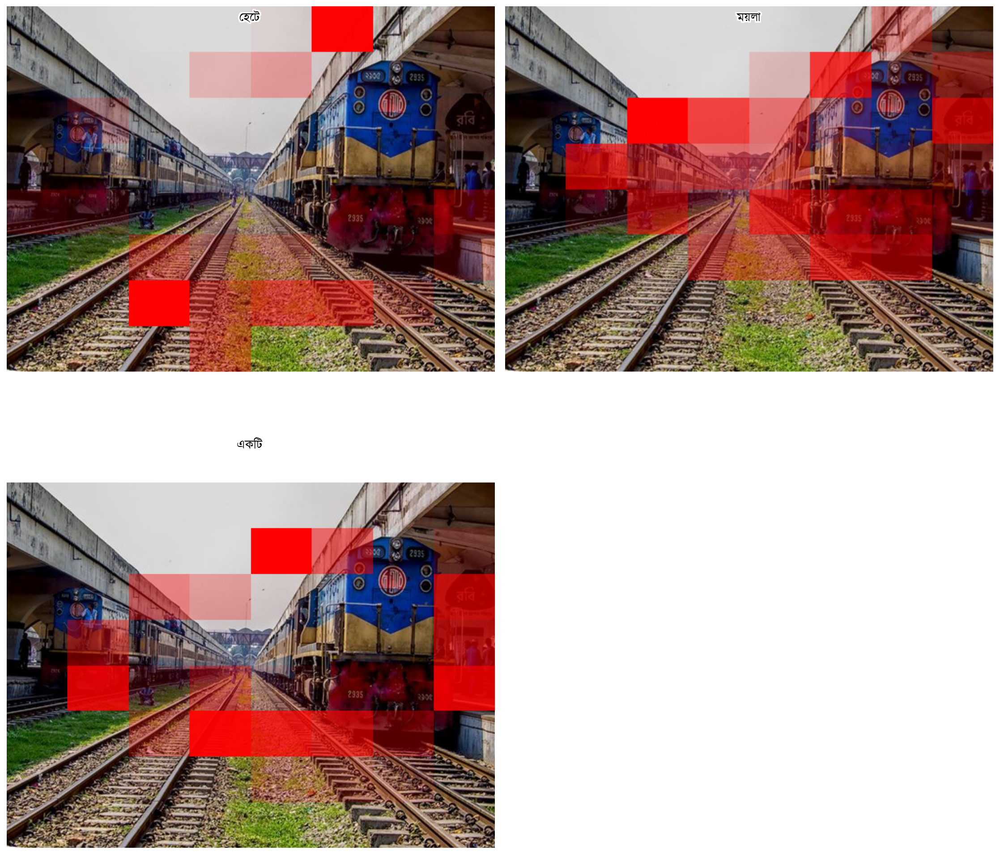

✅ Displayed PIL image with Bengali text inline (Jupyter)

🎯 Mode 2: Random Batch (5 images)
Processed 1/5: /data/test/BNLIT/Bangla Natural Language Image to Text (BNLIT)-Preprocessing and Resizing Dataset-resized-500_375/306.png
Image: /data/test/BNLIT/Bangla Natural Language Image to Text (BNLIT)-Preprocessing and Resizing Dataset-resized-500_375/306.png
✅ GT: দুইজন ছেলে দাড়িয়ে আছে।
🤖 Pred: নীচ খালি হাতে খেলছে তাকিয়ে ওরনা ভিজা
✅ Using Bengali font: Kalpurush
✅ PIL loaded font: /usr/share/fonts/truetype/bengali/Kalpurush-Regular.ttf
✅ Saved attention plot with Bengali text to: /results/generated_images/img_rand_1.png


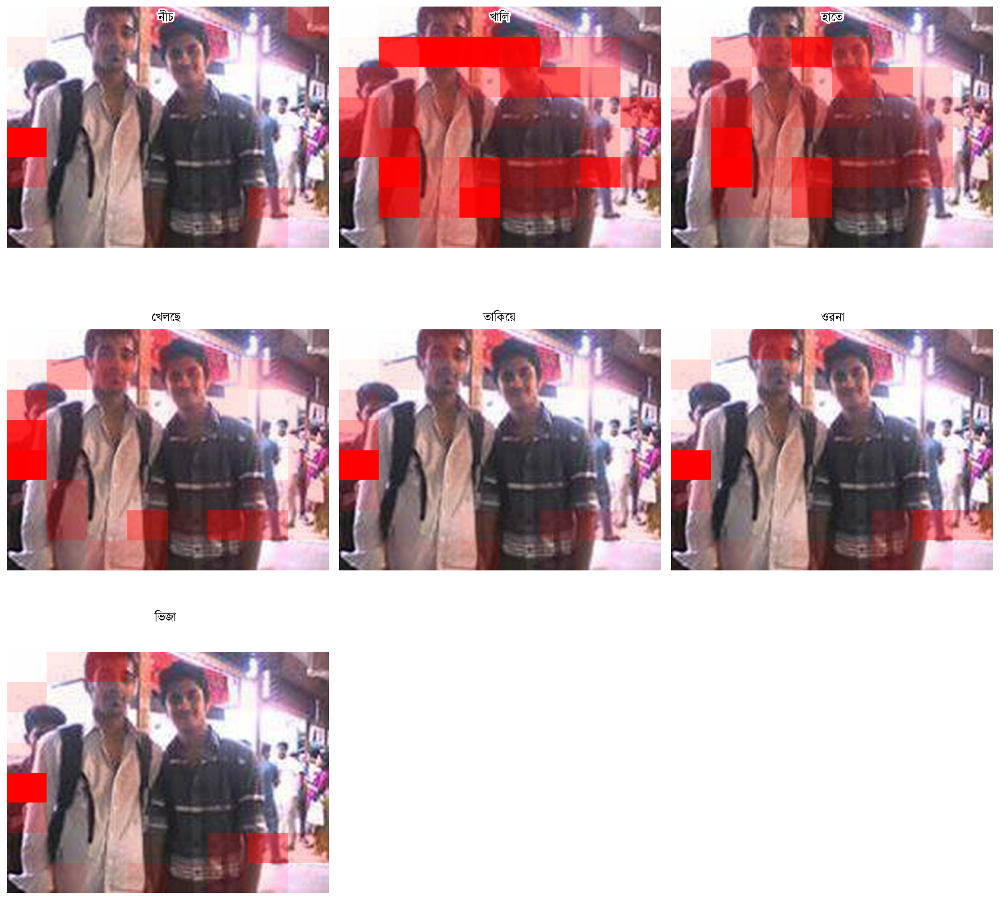

✅ Displayed PIL image with Bengali text inline (Jupyter)
Processed 2/5: /data/test/BNLIT/Bangla Natural Language Image to Text (BNLIT)-Preprocessing and Resizing Dataset-resized-500_375/402.png
Image: /data/test/BNLIT/Bangla Natural Language Image to Text (BNLIT)-Preprocessing and Resizing Dataset-resized-500_375/402.png
✅ GT: ছোট একটি বাচ্চা।
🤖 Pred: আছে বাচ্চা ব্যাগ পাশে আছে গলায় রকমের ধরছে তিভির আছে তাবু পরে পরে নীল
✅ Using Bengali font: Kalpurush
✅ PIL loaded font: /usr/share/fonts/truetype/bengali/Kalpurush-Regular.ttf
✅ Saved attention plot with Bengali text to: /results/generated_images/img_rand_2.png


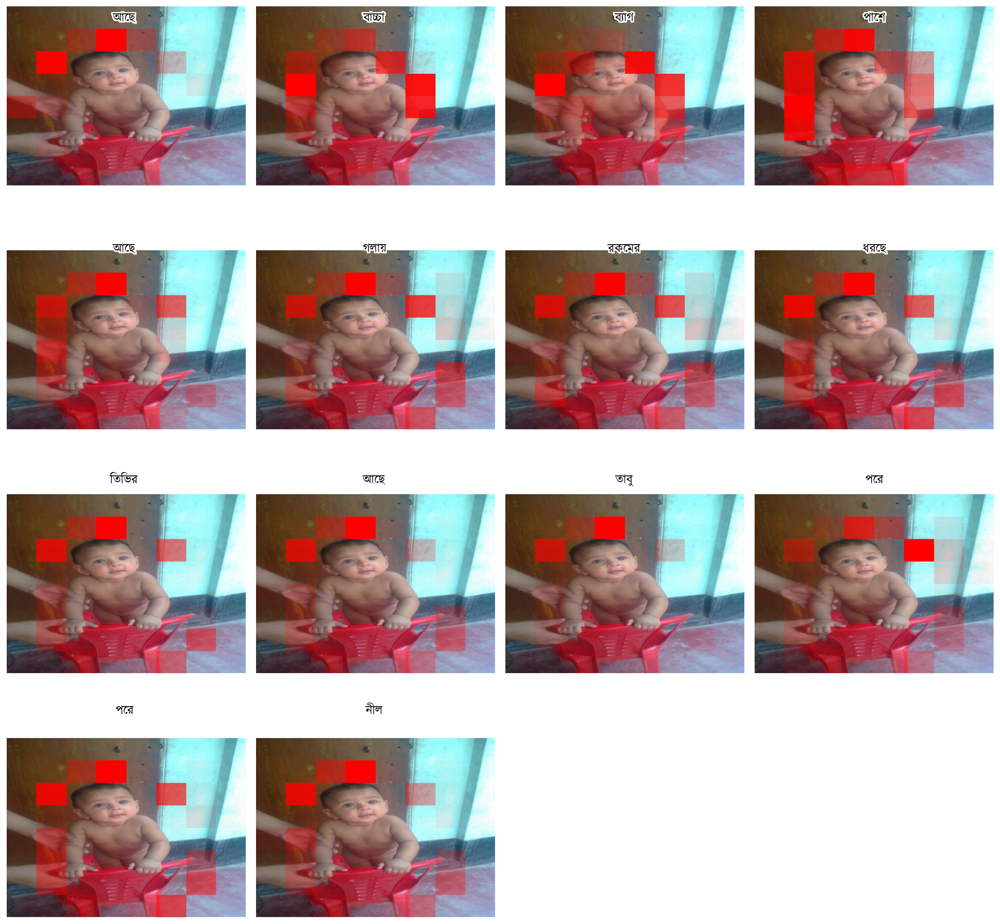

✅ Displayed PIL image with Bengali text inline (Jupyter)
Processed 3/5: /data/test/BNLIT/Bangla Natural Language Image to Text (BNLIT)-Preprocessing and Resizing Dataset-resized-500_375/323.png
Image: /data/test/BNLIT/Bangla Natural Language Image to Text (BNLIT)-Preprocessing and Resizing Dataset-resized-500_375/323.png
✅ GT: কয়েকজন লোক ব্যানার হাতে দাড়িয়ে আছে।
🤖 Pred: হেটে নৌকা আছে। মানুষ মা কাজ যাচ্ছে মানুষ একজন আছে
✅ Using Bengali font: Kalpurush
✅ PIL loaded font: /usr/share/fonts/truetype/bengali/Kalpurush-Regular.ttf
✅ Saved attention plot with Bengali text to: /results/generated_images/img_rand_3.png


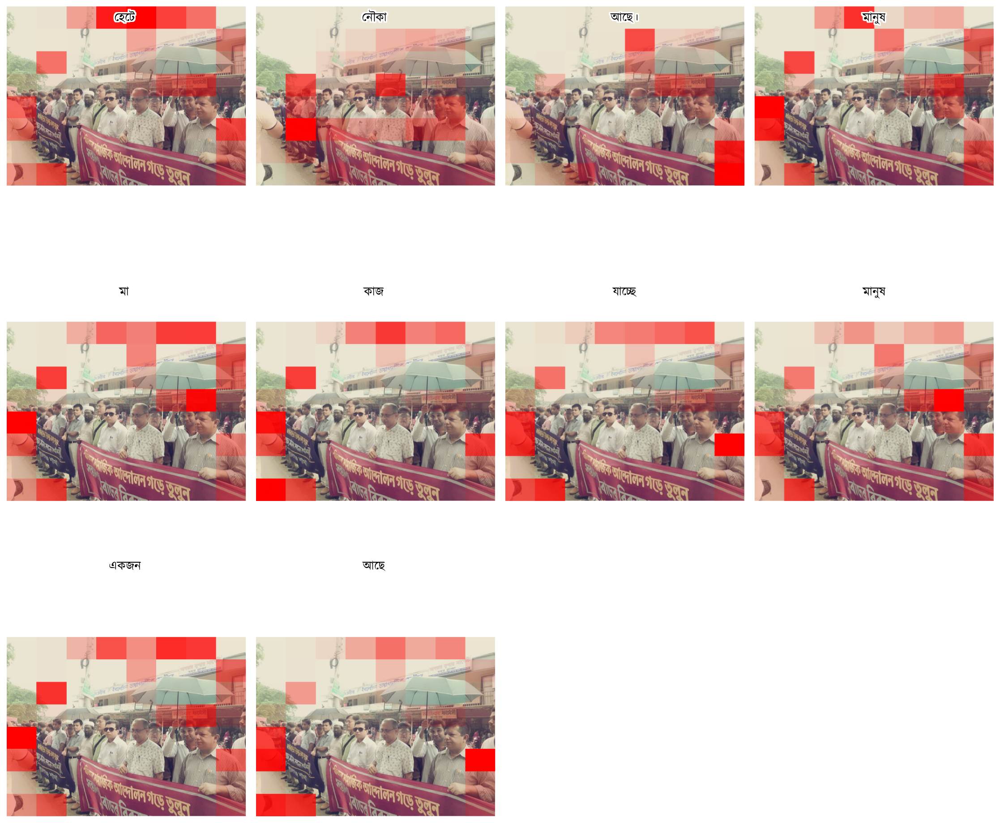

✅ Displayed PIL image with Bengali text inline (Jupyter)
Processed 4/5: /data/test/BNLIT/Bangla Natural Language Image to Text (BNLIT)-Preprocessing and Resizing Dataset-resized-500_375/167.png
Image: /data/test/BNLIT/Bangla Natural Language Image to Text (BNLIT)-Preprocessing and Resizing Dataset-resized-500_375/167.png
✅ GT: একটি ছেলে সিড়িতে বসে আছে পেছনে অনেক ফুলের তোরা।
🤖 Pred: আছে লোক আছে একটি
✅ Using Bengali font: Kalpurush
✅ PIL loaded font: /usr/share/fonts/truetype/bengali/Kalpurush-Regular.ttf
✅ Saved attention plot with Bengali text to: /results/generated_images/img_rand_4.png


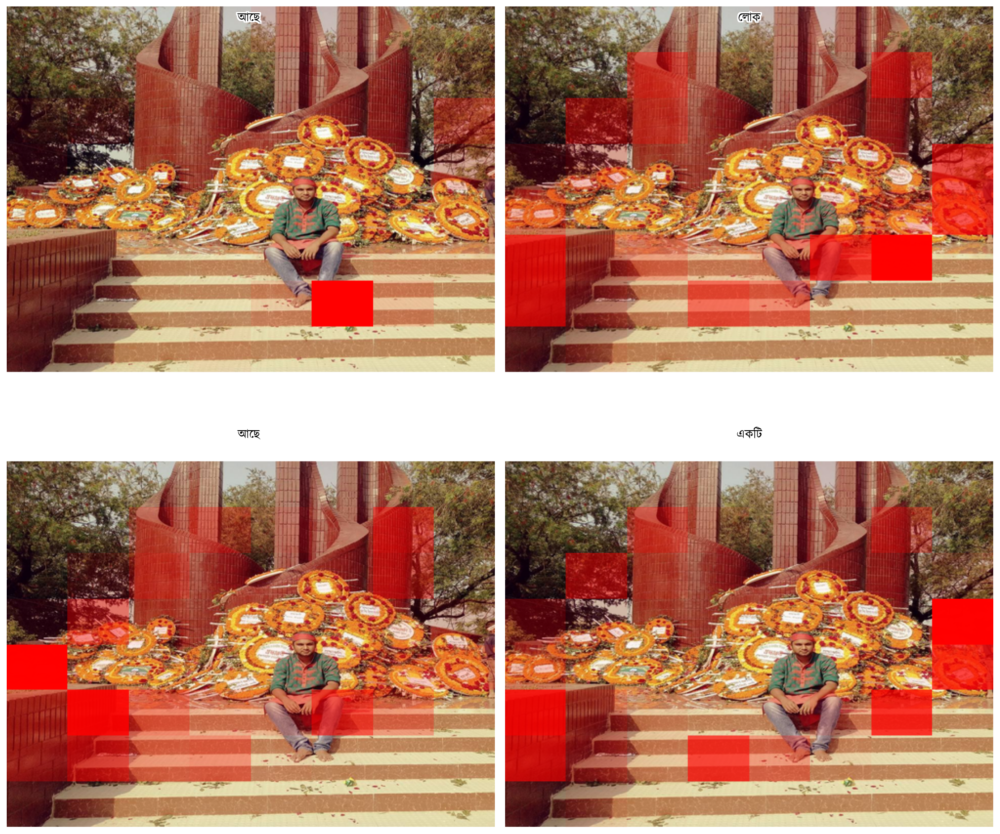

✅ Displayed PIL image with Bengali text inline (Jupyter)
Processed 5/5: /data/test/BNATURE/Pictures/6297.jpg
Image: /data/test/BNATURE/Pictures/6297.jpg
✅ GT: একজন নারীর হাত ধরে আছে
🤖 Pred: শিশু দিয়ে একটি
✅ Using Bengali font: Kalpurush
✅ PIL loaded font: /usr/share/fonts/truetype/bengali/Kalpurush-Regular.ttf
✅ Saved attention plot with Bengali text to: /results/generated_images/img_rand_5.png

🎯 Mode 3: First 3 Validation Images
Processed 1/3: /data/test/BNATURE/Pictures/6122.jpg
Image: /data/test/BNATURE/Pictures/6122.jpg
✅ GT: একটি ভাঙা নৌকার অংশ আছে।
🤖 Pred: নৌকা আছে মটর যার মারছে। তিনজন নৌকায়
✅ Using Bengali font: Kalpurush
✅ PIL loaded font: /usr/share/fonts/truetype/bengali/Kalpurush-Regular.ttf
✅ Saved attention plot with Bengali text to: /results/generated_images/img_first_1.png
✅ Using Bengali font: Kalpurush
✅ PIL loaded font: /usr/share/fonts/truetype/bengali/Kalpurush-Regular.ttf
✅ Saved attention plot with Bengali text to: /results/generated_images/._paper_att_tmp.png
✅ 

In [54]:
print("🚀 Starting Image Caption Inference Pipeline")
print("=" * 50)

print("\n📋 Available Inference Modes:")
print("1. Single random validation image")
print("2. Batch of random validation images")
print("3. First N validation images")
print("4. All validation images")

# Mode 1: Single random image
print("\n🎯 Mode 1: Single Random Image")
run_random_single()

# Mode 2: Random batch
print("\n🎯 Mode 2: Random Batch (5 images)")
run_random_batch(num_images=5)

# Mode 3: First N images
print("\n🎯 Mode 3: First 3 Validation Images")
run_first_n(num_images=3)

# Mode 4: All validation images
print("\n🎯 Mode 4: All Validation Images")
run_all(save_output=True)

# ----------------------------
# Generate final report
# ----------------------------
print("\n📊 Generating Final Report...")
finalize_report()

print("\n🎉 Inference Complete!")
print(f"📁 Check results in: {output_dir}")
print(f"🖼️ Attention plots in: {generated_images_dir}")
print(f"📝 HTML report at: {html_report_path}")